In [1]:
import torch
import torch.nn as nn

import matplotlib.pyplot as plt
import numpy as np
import time

import shutil

import pandas as pd
from scipy.io import loadmat
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
import torch.nn.functional as F
import copy
import scipy.io
import time
np.random.seed(14894)
torch.manual_seed(14894)


In [2]:
print('hello')

hello


In [11]:
hyper_params_ENCODER={'input_size':1,'hidden_size':65,'num_layer':1,'encoded_size':3}

hyper_params_DECODER={'encoded_size':3,'hidden_size':65,'num_layer':1,'decoded_size':1}

device = torch.device('cpu')

print(device)

print_freq = 400


trainer_info = {'epochs': 300,
                'train_size': 4501,
                'train_batch': 16,
                'test_batch': 256,
                'lr0':0.8e-3,
                'lr_decay': 0.50}


note = 'LSTM_Spatial_Encoder'
model_name = 'model' + '_' + str(trainer_info['train_size']) + 'train_' + str(hyper_params_ENCODER['num_layer']) + 'layer_' + str(hyper_params_DECODER['hidden_size']) + 'hid_' + str(trainer_info['epochs']) + 'ep_' + note



cpu


In [12]:
class LSTM_encoder(torch.nn.Module):

    def __init__(self,hyper_params_ENCODER):
        super().__init__()
        input_size = hyper_params_ENCODER['input_size']
        self.hidden_size = hyper_params_ENCODER['hidden_size']
        self.num_layers = hyper_params_ENCODER['num_layer']
        self.reduced_size = hyper_params_ENCODER['encoded_size']
        self.leakrelu = torch.nn.LeakyReLU()
        self.tanh=torch.nn.Tanh()
        self.LSTM = torch.nn.LSTM(input_size, self.hidden_size, self.num_layers,bidirectional=False, batch_first=True)
        self.fc1 = torch.nn.Linear(self.hidden_size, self.reduced_size)
       

    def forward(self, x):
        '''a0 = torch.zeros(self.num_layers, x.shape[0], self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.shape[0], self.hidden_size).to(device)'''
        
        a0=torch.randn((self.num_layers, x.shape[0], self.hidden_size), dtype=torch.float).to(device)
        c0=torch.randn((self.num_layers, x.shape[0], self.hidden_size), dtype=torch.float).to(device)
            
        out, (a,c) = self.LSTM(x, (a0,c0))
        
        #out,a = self.LSTM(x,a0)

        out = self.leakrelu(out)
        out = self.fc1(out)
        #out=self.tanh(out)
   
        #return out,x,(a,c)
        return out,x,a

class LSTM_decoder(torch.nn.Module):

    def __init__(self,hyper_params_DECODED,coord):
        super().__init__()

        self.reduced_size = hyper_params_DECODED['encoded_size']
        self.hidden_size = hyper_params_DECODED['hidden_size']
        self.num_layers = hyper_params_DECODED['num_layer']
        self.input_size = hyper_params_DECODED['decoded_size']
        self.coord=coord

        self.leakrelu = torch.nn.LeakyReLU()
        self.tanh= torch.nn.Tanh()
        self.LSTM = torch.nn.LSTM(self.reduced_size+1, self.hidden_size, self.num_layers, batch_first=True)
        self.fc1 = torch.nn.Linear(self.hidden_size, self.input_size)
        

    '''def forward(self, a0_init,x,aa0,cc0):

    # a0_init = self.fc1(a00)
    #a0 = torch.zeros(self.num_layers, a0_init.shape[0], self.hidden_size).to(device)
    #c0 = torch.zeros(self.num_layers, a0_init.shape[0], self.hidden_size).to(device) # My method

    a0 = torch.zeros(self.num_layers, a0_init.shape[0], self.reduced_size).to(device)


    #print(a0_init.shape)
    a0[0, :, :] = a0_init.clone()
    aug_a = a0_init.repeat(1, x.shape[1]).reshape(a0_init.shape[0],

                                           x.shape[1], a0_init.shape[1])

    #c0[0, :, :] = a0_init.clone()  # My moethod


    #print(aug_a.shape)
    #print(samples[:,:,0].shape)

    coord1=self.coord.repeat(x.shape[0],1)

    aug_a1=torch.cat((aug_a,(coord1).unsqueeze(2).to(device).float()),dim=2)
    # inp = torch.cat(aug_a, axis=2)
    out, (a,c) = self.LSTM(aug_a1, (aa0,cc0))
    out = self.leakrelu(out)
    out = self.fc1(out)
    return out'''
        
    def forward(self, a0_init,x):

    # a0_init = self.fc1(a00)
        a0 = torch.zeros(self.num_layers, a0_init.shape[0], self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, a0_init.shape[0], self.hidden_size).to(device)



        #print(a0_init.shape)
        #a0[:, :, :] = a0_init.repeat(a0.shape[0],1,1).clone()
        aug_a = a0_init.repeat(1, x.shape[1]).reshape(a0_init.shape[0],

                                               x.shape[1], a0_init.shape[1])

        #c0[:, :, :] = a0_init.repeat(a0.shape[0],1,1).clone()


        #print(aug_a.shape)
        #print(samples[:,:,0].shape)

        coord1=self.coord.repeat(x.shape[0],1)

        aug_a1=torch.cat((aug_a,(coord1).unsqueeze(2).to(device).float()),dim=2)
        # inp = torch.cat(aug_a, axis=2)
        out, (a,c) = self.LSTM(aug_a1, (a0,c0))
        #out,a = self.LSTM(aug_a1,a0)
        out = self.leakrelu(out)
        
        out = self.fc1(out)
        #out = self.tanh(out)
        return out


class LSTM_encoder_decoder(torch.nn.Module):

    def __init__(self,hyper_params_ENCODER,hyper_params_DECODER,coord):
        super().__init__()

        self.encoder = LSTM_encoder(hyper_params_ENCODER)
        self.decoder = LSTM_decoder(hyper_params_DECODER,coord)
        self.coord=coord
        
        self.init_weights()

    def init_weights(self):
        with torch.set_grad_enabled(True):
            
            for name, param in self.named_parameters():
                print(f"Initializing parameter '{name}' with shape: {param.shape}")
                if 'weight' in name:
                    nn.init.xavier_uniform_(param)
                    #nn.init.orthogonal_(param)
                elif 'bias' in name:
                    nn.init.constant_(param, 0.0)

    def forward(self, inp_encoder):
        with torch.set_grad_enabled(True):
            #y_code,x,(a,c) = self.encoder(inp_encoder)
            y_code,x,a = self.encoder(inp_encoder)
            #print(y_code[:, y_code.shape[1] - 1].shape)
            y_recovered = self.decoder(y_code[:, y_code.shape[1]-1],x)
            return y_recovered,y_code[:, y_code.shape[1] - 1]

In [13]:
class MinMax_Scaler(object):

    def __init__(self, data, keep_data=False):
        self.min = np.min(data, axis=(0, 1), keepdims=True)
        self.max = np.max(data, axis=(0, 1), keepdims=True)

        if keep_data is True:
            self.data = self.transform(data, tensor=False)
        else:
            self.data = []

    def transform(self, data, tensor_format=False):
        if tensor_format is False:
            data = (data - self.min) / (self.max - self.min)
        else:
            min_tensor = torch.tensor(self.min).to(device)
            max_tensor = torch.tensor(self.max).to(device)
            for c in range(data.shape[2]):
                data[:, :, c] = torch.div(torch.sub(data[:, :, c], min_tensor[0, 0, c]), torch.sub(max_tensor[0, 0, c], min_tensor[0, 0, c]))
        return data

    def inv_transform(self, data, tensor_format=False):
        if tensor_format is False:
            data = data * (self.max - self.min) + self.min
        else:
            min_tensor = torch.tensor(self.min).to(device)
            max_tensor = torch.tensor(self.max).to(device)
            for c in range(data.shape[2]):
                data[:, :, c] = torch.add(torch.mul(data[:, :, c], torch.sub(max_tensor[0, 0, c], min_tensor[0, 0, c])), min_tensor[0, 0, c])
        return data

class MyDataset(torch.utils.data.Dataset):

    def __init__(self, strain, stress):
        self.strain = strain
        self.stress = stress

    def __len__(self):
        return self.strain.shape[0]

    def __getitem__(self, index):
        return self.strain[index], self.stress[index]


class AverageMeter(object):
    # Computes and stores the average and current value

    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def customized_loss(output, target):

    mse = torch.nn.MSELoss()

    output1 = output[:, :, 0:3]
    output2 = output[:, :, 3:6]

    target1 = target[:, :, 0:3]
    target2 = target[:, :, 3:6]

    return 0.5 * torch.maximum(mse(output1, target1), mse(output2, target2))

def train_step(train_loader, model, criterion, optimizer, epoch, net_info):
    batch_time = AverageMeter()
    data_time = AverageMeter()
    losses = AverageMeter()

    # switch to train mode
    model.train()

    end = time.time()
    for i, (input, target) in enumerate(train_loader):
        # measure data loading time
        data_time.update(time.time() - end)

        input = input.to(device)
        target = target.to(device)

        # compute output
        output,enc = model(input)
    
        loss = criterion(output, target)
        
        #print(enc)
        # measure accuracy and record loss
        losses.update(loss.item(), input.size(0))

        # compute gradient and do the SGD step
        optimizer.zero_grad()
        loss.backward()
        
        '''for name, param in model.named_parameters():
            if param.grad is not None:
                print(f"Gradient for parameter '{name}':\n{param.grad}")
            else:
                print(f"No gradient for parameter '{name}'")'''

        # torch.nn.utils.clip_grad_norm_(model.parameters(), 0.1)
        optimizer.step()

        # measure elapsed time
        batch_time.update(time.time() - end)
        end = time.time()

        if epoch % 25 == 0:
            if i % print_freq == 0:
                curr_lr = optimizer.param_groups[0]['lr']
                print('Epoch: [{0}/{1}][{2}/{3}]\t'
                    'LR: {4}\t'
                    'Time {batch_time.val:.3f} ({batch_time.avg:.3f})\t'
                    'Data {data_time.val:.3f} ({data_time.avg:.3f})\t'
                    'Loss {loss.val:.7f} ({loss.avg:.6f})\t'.format(
                    epoch, net_info['epochs'], i, len(train_loader), curr_lr,
                    batch_time=batch_time, data_time=data_time, loss=losses))
    return losses.avg


def test_step(test_loader, model, criterion, epoch):
    batch_time = AverageMeter()
    losses = AverageMeter()
    # violation = AverageMeter()

    # switch to evaluate mode
    model.eval()

    end = time.time()
    for i, (input, target) in enumerate(test_loader):

        input = input.to(device)
        target = target.to(device)

        # compute output
        output,_ = model(input)
        loss = criterion(output, target)

        # measure accuracy and record loss
        losses.update(loss.item(), input.size(0))

        # measure elapsed time
        batch_time.update(time.time() - end)
        end = time.time()

        if epoch % 25 == 0:
            if i % print_freq == 0:
                print('Test: [{0}/{1}]\t'
                    'Time {batch_time.val:.3f} ({batch_time.avg:.3f})\t'
                    'Loss {loss.val:.7f} ({loss.avg:.4f})\t'.format(
                    i, len(test_loader), batch_time=batch_time, loss=losses))

    return losses.avg

#@title train_RNN()
def save_checkpoint(state, is_best, filename='checkpoint.pth.tar'):
    torch.save(state, filename)
    if is_best:
        shutil.copyfile(filename, 'model_Spatial_Temperature_future3.pth.tar')


def train_LSTM_autoencoder(model, net_info, train_loader, test_loader,hyper_params_ENCODER, hyper_params_DECODER):

    epochs = net_info['epochs']
    train_losses = np.empty([epochs, 1])
    test_losses = np.empty([epochs, 1])

    min_loss = 1e4

    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=net_info['lr0'])#,weight_decay=1e-8)

    for epoch in range(epochs):
        # adjust learning rate
        if epoch >= 25:
            if epoch % 25== 0:
                for param_group in optimizer.param_groups:
                    param_group['lr'] *= net_info['lr_decay']

        # train for one epoch
        train_losses_temp = train_step(train_loader, model, criterion, optimizer, epoch, net_info)
        train_losses[epoch] = train_losses_temp

        # evaluate on test set
        test_losses_temp = test_step(test_loader, model, criterion, epoch)
        test_losses[epoch] = test_losses_temp

        # remember best MSE and save checkpoint
        is_best = test_losses[epoch] < min_loss
        min_loss = min(test_losses[epoch], min_loss)
        save_checkpoint({
            'epoch': epoch + 1,
            'state_dict': model.state_dict(),
            'min_loss': min_loss,
            'optimizer': optimizer.state_dict(),
        }, is_best)

    test_losses.tofile('test_loss' + str(net_info['train_size']) + '2l50h.csv', sep=",", format="%10.5f")
    train_losses.tofile('train_loss' + str(net_info['train_size']) + '2l50h.csv', sep=",", format="%10.5f")

    plt.figure(figsize=(10, 7))
    plt.plot(train_losses, label='training')
    plt.plot(test_losses, '--', label='test')
    plt.xlabel('epoch')
    plt.ylabel('MSE')
    plt.title('Training and Test Loss\n(hidden size=%s, num layers=%s model'%(hyper_params_ENCODER['hidden_size'],hyper_params_ENCODER['num_layer']))
    plt.yscale('log')
    plt.legend()
    plt.show()
    return model

#@title main_program()
def main_program(T_S, T_S_out,val_T_S, val_T_S_out,hyper_params_ENCODER, hyper_params_DECODER, model,trainer_info, model_name):
    num_sample = trainer_info['train_size']
    T_S_train = T_S[:, :, :]
    T_S_out_train = T_S_out[:, :, :]
    training_set = MyDataset(T_S_train, T_S_out_train)

    T_S_test = val_T_S[:, :, :]
    T_S_out_test = val_T_S_out[:, :, :]
    val_set = MyDataset(T_S_test, T_S_out_test)

    # create training/test loaders
    train_loader = torch.utils.data.DataLoader(dataset=training_set,
                                               batch_size=trainer_info['train_batch'],
                                               shuffle=True)

    test_loader = torch.utils.data.DataLoader(dataset=val_set,
                                              batch_size=trainer_info['test_batch'],
                                              shuffle=True)

    model = train_LSTM_autoencoder(model, trainer_info, train_loader, test_loader,hyper_params_ENCODER, hyper_params_DECODER)
    torch.save(model.state_dict(), model_name)

    return model



In [14]:
import copy

data=loadmat("Input_ROM")

Input=data['TT'].astype(np.float32)

Input1=Input[0:1000,:,0:1]

Input2=Input[2000:6000,:,0:1]

Input3=Input[7000:8501,:,0:1]

Valx=Input[6000:7000,:,0:1].astype(np.float32)

x=np.concatenate([Input1,Input2,Input3],axis=0).astype(np.float32)


In=MinMax_Scaler(x)
x_tr=In.transform(x)
Valx_tr=In.transform(Valx)


coordinates=pd.read_excel("coordinates.xlsx",header=None)
coord=coordinates.iloc[:].values.reshape(-1,1)
#coord=coord[::6]


ZZ=copy.deepcopy(coord.T)

cord=MinMaxScaler()

coord=cord.fit_transform(coord)

coord=torch.from_numpy(coord).reshape(1,-1).float().to(device)

time=loadmat("Input_BC")
time=time['BC'].astype(np.float32)[:,0]

hours=time/(3600)








In [15]:
import copy

data=loadmat("Input_ROM")

Input=data['TT'].astype(np.float32)

Input1=Input[0:1000,:,0:1]
Input2=Input[1500:7000,:,0:1]


Valx=Input[1000:1500,:,0:1].astype(np.float32)

x=np.concatenate([Input1,Input2],axis=0).astype(np.float32)



In=MinMax_Scaler(x)
x_tr=In.transform(x)
Valx_tr=In.transform(Valx)


coordinates=pd.read_excel("coordinates.xlsx",header=None)
coord=coordinates.iloc[:].values.reshape(-1,1)
#coord=coord[::6]
time=loadmat("Input_BC")
time=time['BC'].astype(np.float32)[:,0]

hours=time/(3600)

ZZ=copy.deepcopy(coord.T)

cord=MinMaxScaler()

coord=cord.fit_transform(coord)

coord=torch.from_numpy(coord).reshape(1,-1).float().to(device)

In [7]:
print(hours/24)

[ 0.          0.01820515  0.03049394 ... 13.973998   13.975862
 13.977803  ]


In [8]:
print(Input1.shape)

(1000, 240, 1)


In [18]:
print(x_tr.shape)
print(coord.shape)

(6500, 240, 1)
torch.Size([1, 240])


In [31]:
'''import time

start_time = time.time()
model=LSTM_encoder_decoder(hyper_params_ENCODER, hyper_params_DECODER,coord).to(device)
model = main_program(x_tr, x_tr,Valx_tr,Valx_tr,hyper_params_ENCODER, hyper_params_DECODER,model, trainer_info, model_name)
end_time = time.time()

# Calculate and print the total execution time
total_execution_time = end_time - start_time
print(f"Total execution time: {total_execution_time} seconds")'''

Initializing parameter 'encoder.LSTM.weight_ih_l0' with shape: torch.Size([260, 1])
Initializing parameter 'encoder.LSTM.weight_hh_l0' with shape: torch.Size([260, 65])
Initializing parameter 'encoder.LSTM.bias_ih_l0' with shape: torch.Size([260])
Initializing parameter 'encoder.LSTM.bias_hh_l0' with shape: torch.Size([260])
Initializing parameter 'encoder.fc1.weight' with shape: torch.Size([2, 65])
Initializing parameter 'encoder.fc1.bias' with shape: torch.Size([2])
Initializing parameter 'decoder.LSTM.weight_ih_l0' with shape: torch.Size([260, 3])
Initializing parameter 'decoder.LSTM.weight_hh_l0' with shape: torch.Size([260, 65])
Initializing parameter 'decoder.LSTM.bias_ih_l0' with shape: torch.Size([260])
Initializing parameter 'decoder.LSTM.bias_hh_l0' with shape: torch.Size([260])
Initializing parameter 'decoder.fc1.weight' with shape: torch.Size([1, 65])
Initializing parameter 'decoder.fc1.bias' with shape: torch.Size([1])
Epoch: [0/300][0/407]	LR: 0.0008	Time 0.017 (0.017)	Da

KeyboardInterrupt: 

In [ ]:
'''for name, param in model.named_parameters():
    print(name, param.grad)'''

In [16]:
#best_model_params = torch.load('model_Spatial_Temperature_improving.pth.tar', map_location=device)['state_dict']



#best_model_params = torch.load('model_best_LSTM_Spatial_Temperature.pth.tar', map_location=device)['state_dict']

best_model_params = torch.load('model_Spatial_Temperature_future2.pth.tar', map_location=device)['state_dict']


In [17]:
model=LSTM_encoder_decoder(hyper_params_ENCODER, hyper_params_DECODER,coord).to(device)
model.load_state_dict(best_model_params)

Initializing parameter 'encoder.LSTM.weight_ih_l0' with shape: torch.Size([260, 1])
Initializing parameter 'encoder.LSTM.weight_hh_l0' with shape: torch.Size([260, 65])
Initializing parameter 'encoder.LSTM.bias_ih_l0' with shape: torch.Size([260])
Initializing parameter 'encoder.LSTM.bias_hh_l0' with shape: torch.Size([260])
Initializing parameter 'encoder.fc1.weight' with shape: torch.Size([3, 65])
Initializing parameter 'encoder.fc1.bias' with shape: torch.Size([3])
Initializing parameter 'decoder.LSTM.weight_ih_l0' with shape: torch.Size([260, 4])
Initializing parameter 'decoder.LSTM.weight_hh_l0' with shape: torch.Size([260, 65])
Initializing parameter 'decoder.LSTM.bias_ih_l0' with shape: torch.Size([260])
Initializing parameter 'decoder.LSTM.bias_hh_l0' with shape: torch.Size([260])
Initializing parameter 'decoder.fc1.weight' with shape: torch.Size([1, 65])
Initializing parameter 'decoder.fc1.bias' with shape: torch.Size([1])


<All keys matched successfully>

In [18]:
#reconstruction,reduced_state=model(torch.from_numpy(x_tr).to(device))

In [19]:
time_step=10
time_step_test=10
encoded_size=3

In [15]:
Testx=Input[1000-time_step_test:4000,:,0:1] ## C
Testx_tr=In.transform(Testx)
#Testx_tr=torch.from_numpy(Text_tr).float().to(device)
print(Testx_tr.shape)

(3010, 240, 1)


In [20]:
Testx=Input[7000-time_step_test:,:,0:1] ## C
Testx_tr=In.transform(Testx)
#Testx_tr=torch.from_numpy(Text_tr).float().to(device)
print(Testx_tr.shape)

(1511, 240, 1)


In [ ]:
# Testing for completely different regime(no thermal inversion layer) for the entire dataset!!!!
data=loadmat("Input_ROM_No_TI")

Input_NTI=data['TT'].astype(np.float32)

Test_NTI=Input_NTI[:,:,0:1]

tes=MinMax_Scaler(Test_NTI)
Test_NTI_tr=tes.transform(Test_NTI)

print(Test_NTI_tr.shape)



/tmp/ipykernel_86071/2944224747.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i)


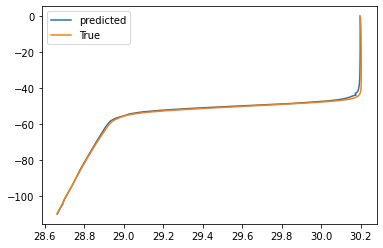

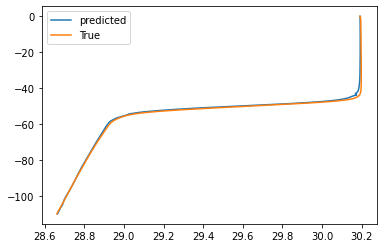

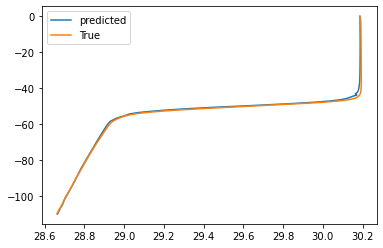

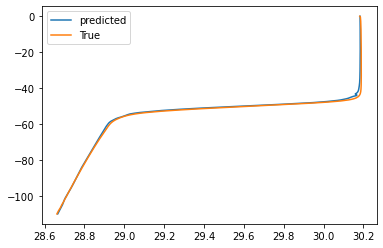

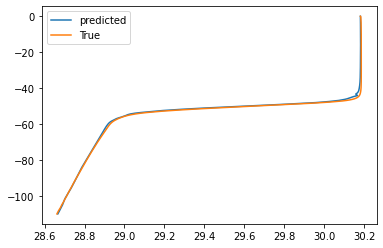

...

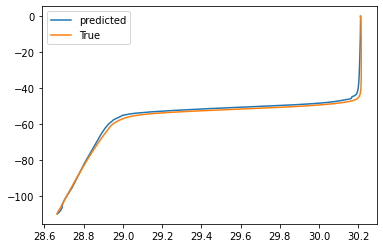

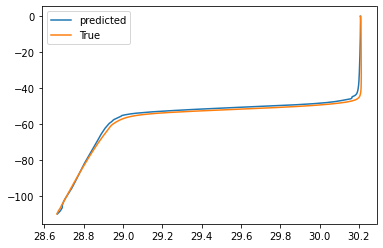

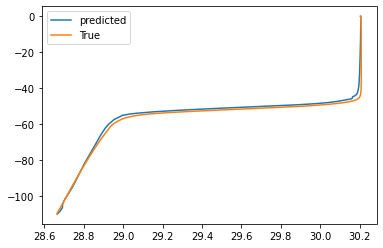

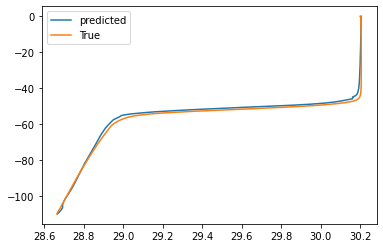

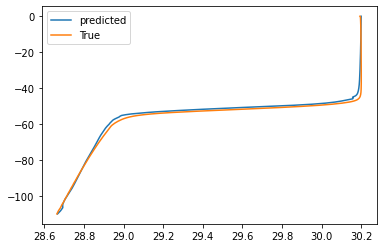

In [21]:
x_rec=torch.zeros((Testx_tr.shape[0],x_tr.shape[1],x_tr.shape[2]))
j=0
for i in range(Testx_tr.shape[0]):
    
    x_rec[i,:,:],_=model((torch.tensor(Testx_tr[i:i+1,:,:]).to(device)))
    if i%25==0:
        plt.figure(i)
        plt.plot(In.inv_transform(x_rec[i:i+1,:,:].detach().numpy())[:,:,0].T,ZZ.T,label='predicted')
        plt.plot(In.inv_transform(Testx_tr[i:i+1,:,:])[:,:,0].T,ZZ.T,label='True')
        plt.legend()
    j=j+1

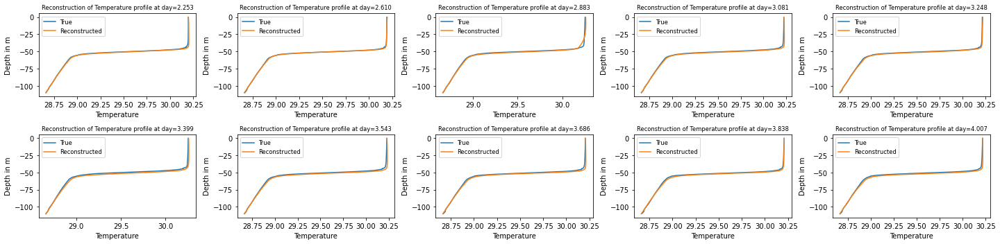

In [22]:
fig, ax = plt.subplots(2,5, figsize=(20,5))
days=hours/24
p = 0
timeSteps=p+1000
for i in range(2):
    for j in range(5):
        ax[i, j].plot(In.inv_transform(x_rec[p,:,:].detach().numpy())[:,:,0].T,ZZ.T,label='predicted')
        ax[i, j].plot(In.inv_transform(Testx_tr[p,:,:])[:,:,0].T,ZZ.T,label='True')
        ax[i, j].legend(['True', 'Reconstructed'], fontsize='small')
        ax[i, j].set_xlabel('Temperature')
        ax[i, j].set_ylabel('Depth in m')
        ax[i, j].set_title(f'Reconstruction of Temperature profile at day=%1.3f' % days[timeSteps], fontsize='small')
        p += 150
        timeSteps += 150

plt.tight_layout()
plt.show()

'print(In.inv_transform(x_rec.detach().numpy())[:,-1,0])\nprint((x)[:,-1,0])'

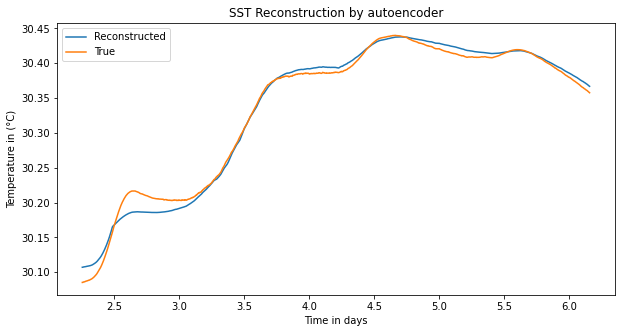

In [18]:
fig,ax= plt.subplots(1,1,figsize=(10,5))
t=np.linspace(7000,8501,1501,endpoint=False)
ax.plot(hours[1000:4000]/24,In.inv_transform(x_rec.detach().numpy())[time_step:,-1,0],label='Reconstructed')
ax.plot(hours[1000:4000]/24,In.inv_transform(Testx_tr)[time_step:,-1,0],label='True')
ax.set_xlabel('Time in days')
ax.set_ylabel('Temperature in (\u00b0C)')
ax.set_title('SST Reconstruction by autoencoder')
ax.legend()
'''ax[1].plot(In.inv_transform(x_rec.detach().numpy())[:,-1,1],label='Predicted')
ax[1].plot(In.inv_transform(Testx_tr)[:,-1,1],label='True')
ax[1].legend()'''

'''print(In.inv_transform(x_rec.detach().numpy())[:,-1,0])
print((x)[:,-1,0])'''




/tmp/ipykernel_24438/4081658088.py:11: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  a=ax[1].pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
/tmp/ipykernel_24438/4081658088.py:12: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  b=ax[0].pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0],label='actual')


Text(0.04, 0.45, 'Depth (meters)')

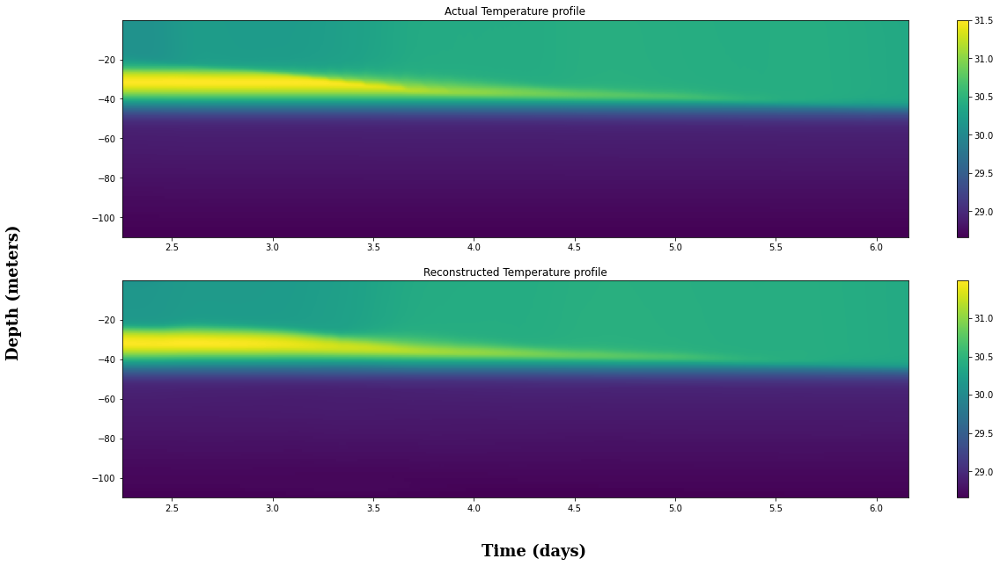

In [20]:
#pcolor plots
t=np.linspace(1000,4000,3000,endpoint=False)
[xx, tt] = np.meshgrid(ZZ.flatten(), hours[1000:4000]/24)
label_font = {'family': 'serif', 'weight': 'bold', 'size': 18}
fig,ax=plt.subplots(2,1,figsize=(20,10))
'''ax[0].pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,1],label='Actual')
ax[1].pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,1],label='predicted')
ax[0].set_title(' Actual Salinity profile')
ax[1].set_title('Reconstructed salinity profile')'''

a=ax[1].pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
b=ax[0].pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0],label='actual')
ax[1].set_title('Reconstructed Temperature profile')
ax[0].set_title('Actual Temperature profile')
fig.colorbar(b,ax=ax[0])
fig.colorbar(a,ax=ax[1])

fig.text(0.45, 0.04, 'Time (days)', ha='center', va='center',font=label_font)
fig.text(0.04, 0.45, 'Depth (meters)', ha='center', va='center', rotation='vertical',font=label_font)


/tmp/ipykernel_24438/3836007453.py:23: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im=ax.pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0]-In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0],label='predicted',norm=norm, cmap="RdBu_r")


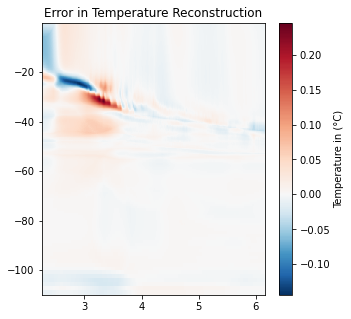

In [21]:
'''fig,ax=plt.subplots(1,1,figsize=(5,5))
im=ax.pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,1]-In.inv_transform(Testx_tr[time_step:,:,:])[:,:,1],label='predicted')
ax.set_title('Error for Salinity Reconstruction')

colo=plt.colorbar(im, ax=ax)
colo.set_label('Salinity erro in psu')
plt.show()'''

'''fig,ax=plt.subplots(1,1,figsize=(5,5))

im=ax.pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0]-In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
ax.set_title('Error for Temperature Reconstruction')

colo=plt.colorbar(im, ax=ax)
colo.set_label('Temperature (\u00b0C)')
plt.show()'''


fig,ax=plt.subplots(1,1,figsize=(5,5))
from matplotlib.colors import TwoSlopeNorm

norm = TwoSlopeNorm(vmin=np.min(In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0]-In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0]), vcenter=0, vmax=np.max(In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0]-In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0]))
im=ax.pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0]-In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0],label='predicted',norm=norm, cmap="RdBu_r")


#im=ax.pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0]-In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
ax.set_title('Error in Temperature Reconstruction')

colo=plt.colorbar(im, ax=ax)
colo.set_label('Temperature in (\u00b0C)')
plt.show()

In [ ]:
'''for name, param in model.named_parameters():
    print(name, param.grad)
    '''

In [ ]:
'''grads=[]
for param in model.parameters():
    grads.append(param.grad.view(-1))
grads = torch.cat(grads)

print(grads)'''

In [23]:
# Data for training LSTM and DNN

out,reduced_Train= model((torch.tensor(x_tr[:,:,:]).to(device)))

outv,reduced_val=model(torch.tensor(Valx_tr[:,:,:]).to(device))

outT,reduced_test=model(torch.tensor(Testx_tr[:,:,:]).to(device))

print(reduced_Train.shape)
print(reduced_val.shape)
print(reduced_test.shape)

torch.Size([6500, 3])
torch.Size([500, 3])
torch.Size([1511, 3])


In [23]:
# Reduced state for entire 8501
reduced_all=torch.cat([reduced_Train[0:990],reduced_test[:1010],reduced_Train[1000:5000],reduced_val,reduced_Train[5000:]])

In [33]:
# Reduced state for entire 8501
reduced_all=torch.cat([reduced_Train[0:1000],reduced_val,reduced_Train[1000:6500],reduced_test])

In [34]:
filename1='reduced_all.mat'

reduced_al={'red_all':reduced_all.cpu().detach().numpy()}

scipy.io.savemat(filename1,reduced_al)

Text(0.5, 0.98, 'Evolution of three Latent space variables ')

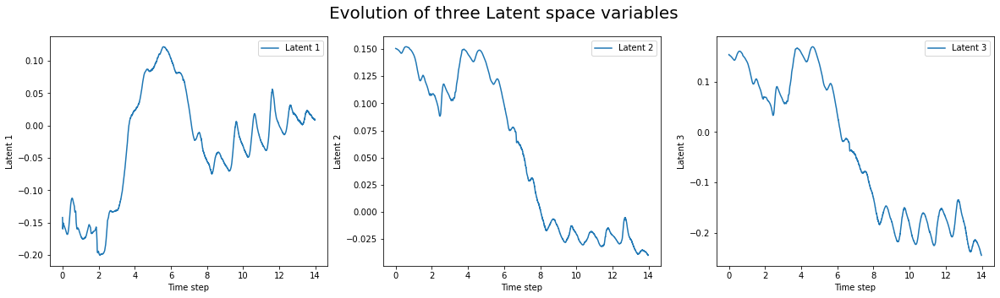

In [25]:
fig, ax = plt.subplots(1, 3, figsize=(20, 5))
Start=0
End=8501
stride=1

days=hours/24


#ax[0].plot(Test_encodings_actual[Start:End:stride, 0],label='Actual')
ax[0].plot(days[Start:End],reduced_all.cpu().detach().numpy()[Start:End:stride, 0],label='Latent 1')
ax[0].set_xlabel('Time step')
ax[0].set_ylabel('Latent 1')

#ax[1].plot(Test_encodings_actual[Start:End:stride, 1],label='Actual')
ax[1].plot(days[Start:End],reduced_all.cpu().detach().numpy()[Start:End:stride, 1],label='Latent 2')
ax[1].set_xlabel('Time step')
ax[1].set_ylabel('Latent 2')

#ax[2].plot(Test_encodings_actual[Start:End:stride, 2],label='Actual')
ax[2].plot(days[Start:End],reduced_all.cpu().detach().numpy()[Start:End:stride, 2],label='Latent 3')
ax[2].set_xlabel('Time step')
ax[2].set_ylabel('Latent 3')

ax[0].legend()
ax[1].legend()
ax[2].legend()

plt.suptitle('Evolution of three Latent space variables ',fontsize=20)


In [ ]:
outT_NTI,reduced_test_NTI=model(torch.tensor(Test_NTI_tr[:,:,:]).to(device))
print(reduced_test_NTI.shape)

In [ ]:
j=0
for i in range(Test_NTI_tr.shape[0]):
    if i%250==0:
        plt.figure(i)
        plt.plot(tes.inv_transform(outT_NTI[i:i+1,:,:].detach().numpy())[:,:,0].T,ZZ.T,label='predicted')
        plt.plot(tes.inv_transform(Test_NTI_tr[i:i+1,:,:])[:,:,0].T,ZZ.T,label='True')
        plt.legend()
    j=j+1

In [ ]:
t=np.linspace(1,8511,8511,endpoint=False)
[xx, tt] = np.meshgrid(ZZ.flatten(), t)

fig,ax=plt.subplots(2,1,figsize=(20,10))
'''ax[0].pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,1],label='Actual')
ax[1].pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,1],label='predicted')
ax[0].set_title(' Actual Salinity profile')
ax[1].set_title('Reconstructed salinity profile')'''

ax[1].pcolormesh(tt,xx,In.inv_transform(outT_NTI[:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
ax[0].pcolormesh(tt,xx,In.inv_transform(Test_NTI_tr[:,:,:])[:,:,0],label='actual')
ax[1].set_title('Reconstructed Temperature profile')
ax[0].set_title('Actual Temperature profile')

In [ ]:
# Saving these reduced states

'''filename='Training.mat'

reduced_train={'red_train':reduced_Train.cpu().detach().numpy()}

scipy.io.savemat(filename,reduced_train)

filename='Validation.mat'

reduced_val={'val_train':reduced_val.cpu().detach().numpy()}

scipy.io.savemat(filename,reduced_val)'''


In [26]:
'''Input_BC=loadmat("Input_BC")
B_C=Input_BC['BC'].astype(np.float32)

BC1=B_C[0:1000,[1,2,3,4]]
BC2=B_C[2000:6000,[1,2,3,4]]
BC3=B_C[7000:8501,[1,2,3,4]]

BC_train=np.concatenate([BC1,BC2,BC3],axis=0)

bc=MinMaxScaler()
BC_train=bc.fit_transform(BC_train)
BC_val=B_C[6000:7000,[1,2,3,4]]

BC_val=bc.transform(BC_val)

BC_test=B_C[1000-time_step_test:8501,[1,2,3,4]]
BC_test=bc.transform(BC_test)
print(BC_test.shape)
print(B_C.shape)'''


(7511, 4)
(8501, 6)


In [26]:
Input_BC=loadmat("Input_BC")
B_C=Input_BC['BC'].astype(np.float32)

BC1=B_C[0:1000,[1,2,3,4]]
BC2=B_C[1500:7000,[1,2,3,4]]
BC_train=np.concatenate([BC1,BC2],axis=0)

bc=MinMaxScaler()
BC_train=bc.fit_transform(BC_train)
BC_val=B_C[1000:1500,[1,2,3,4]]

BC_val=bc.transform(BC_val)

BC_test=B_C[7000-time_step_test:,[1,2,3,4]]
BC_test=bc.transform(BC_test)
print(BC_test.shape)
print(B_C.shape)

(1511, 4)
(8501, 6)


In [ ]:
Input_BC=loadmat("Input_BC_NTI")
B_C=Input_BC['BC'].astype(np.float32)

bc=MinMaxScaler()
BC_test_NTI=B_C[:,[1,2,3,4]]
BC_test_NTI=bc.fit_transform(BC_test_NTI)
print(BC_test_NTI.shape)

In [27]:
BC_cond=4

In [ ]:
#Preparing Training data

Train_In=np.zeros((reduced_Train.shape[0]-time_step*3,time_step,encoded_size+BC_cond))
Train_Out=np.zeros((reduced_Train.shape[0]-time_step*3,encoded_size))

print(reduced_Train.shape)

j=0
for i in range(1000-time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=reduced_Train[i+time_step,:].cpu().detach().numpy()#-reduced_Train[i+time_step-1,:].cpu().detach().numpy()
    j=j+1
    
for i in range(1000,5000-time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=reduced_Train[i+time_step,:].cpu().detach().numpy()#-reduced_Train[i+time_step-1,:].cpu().detach().numpy()
    j=j+1

for i in range(5000,6501-time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=reduced_Train[i+time_step,:].cpu().detach().numpy()#-reduced_Train[i+time_step-1,:].cpu().detach().numpy()
    j=j+1
print(i)
'''print(Train_In[6467,:,:])
print(Train_Out[6467])'''

In [ ]:
Val_In=np.zeros((reduced_val.shape[0]-time_step,time_step,encoded_size+BC_cond))
Val_Out=np.zeros((reduced_val.shape[0]-time_step,encoded_size))


for i in range(1000-time_step):
    Val_In[i,:,0:encoded_size]=reduced_val[i:i+time_step,:].cpu().detach().numpy()
    Val_In[i,:,encoded_size:]=BC_val[i:i+time_step,:]
    Val_Out[i,:]=reduced_val[i+time_step,:].cpu().detach().numpy()#-reduced_val[i+time_step-1,:].cpu().detach().numpy()

print(Val_In.shape)

In [ ]:
Test_In=np.zeros((reduced_test.shape[0]-time_step_test,time_step_test,encoded_size+BC_cond))
Test_Out=np.zeros((reduced_test.shape[0]-time_step_test,encoded_size))


for i in range(3000):
    Test_In[i,:,0:encoded_size]=reduced_test[i:i+time_step_test,:].cpu().detach().numpy()
    Test_In[i,:,encoded_size:]=BC_test[i:i+time_step_test,:]
    Test_Out[i,:]=reduced_test[i+time_step_test,:].cpu().detach().numpy()#-reduced_test[i+time_step-1,:].cpu().detach().numpy()

print(Test_In.shape)

In [28]:
Train_In=np.zeros((reduced_Train.shape[0]-time_step*6,time_step,encoded_size+BC_cond))
Train_Out=np.zeros((reduced_Train.shape[0]-time_step*6,encoded_size*time_step))

print(reduced_Train.shape)

j=0
for i in range(0,1000-2*time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=(reduced_Train[i+time_step:i+2*time_step,:].cpu().detach().numpy()).reshape(1,encoded_size*time_step)
    j=j+1
    
for i in range(1000,5000-2*time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=(reduced_Train[i+time_step:i+2*time_step,:].cpu().detach().numpy()).reshape(1,encoded_size*time_step)
    j=j+1

for i in range(5000,6501-2*time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=(reduced_Train[i+time_step:i+2*time_step,:].cpu().detach().numpy()).reshape(1,encoded_size*time_step)
print(i)


Val_In=np.zeros((reduced_val.shape[0]-2*time_step,time_step,encoded_size+BC_cond))
Val_Out=np.zeros((reduced_val.shape[0]-2*time_step,encoded_size*time_step))


for i in range(1000-2*time_step):
    Val_In[i,:,0:encoded_size]=reduced_val[i:i+time_step,:].cpu().detach().numpy()
    Val_In[i,:,encoded_size:]=BC_val[i:i+time_step,:]
    Val_Out[i,:]=reduced_val[i+time_step:i+2*time_step,:].cpu().detach().numpy().reshape(1,encoded_size*time_step)

print(Val_In.shape)

Test_In=np.zeros((reduced_test.shape[0]-2*time_step,time_step,encoded_size+BC_cond))
Test_Out=np.zeros((reduced_test.shape[0]-2*time_step,encoded_size*time_step))


for i in range(0,3000-time_step):
    Test_In[i,:,0:encoded_size]=reduced_test[i:i+time_step,:].cpu().detach().numpy()
    Test_In[i,:,encoded_size:]=BC_test[i:i+time_step,:]
    Test_Out[i,:]=reduced_test[i+time_step:i+2*time_step,:].cpu().detach().numpy().reshape(1,encoded_size*time_step)

print(Test_In.shape)

torch.Size([6501, 3])
6480
(980, 10, 7)
(2990, 10, 7)


In [ ]:
print(reduced_val.shape)

In [28]:
#Future 
Train_In=np.zeros((reduced_Train.shape[0]-time_step*4,time_step,encoded_size+BC_cond))
Train_Out=np.zeros((reduced_Train.shape[0]-time_step*4,encoded_size*time_step))

print(reduced_Train.shape)

j=0
for i in range(0,1000-2*time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=(reduced_Train[i+time_step:i+2*time_step,:].cpu().detach().numpy()).reshape(1,encoded_size*time_step)
    j=j+1
    
for i in range(1000,6500-2*time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=(reduced_Train[i+time_step:i+2*time_step,:].cpu().detach().numpy()).reshape(1,encoded_size*time_step)
    j=j+1   

Val_In=np.zeros((reduced_val.shape[0]-2*time_step,time_step,encoded_size+BC_cond))
Val_Out=np.zeros((reduced_val.shape[0]-2*time_step,encoded_size*time_step))


for i in range(500-2*time_step):
    Val_In[i,:,0:encoded_size]=reduced_val[i:i+time_step,:].cpu().detach().numpy()
    Val_In[i,:,encoded_size:]=BC_val[i:i+time_step,:]
    Val_Out[i,:]=reduced_val[i+time_step:i+2*time_step,:].cpu().detach().numpy().reshape(1,encoded_size*time_step)

print(Val_In.shape)

Test_In=np.zeros((reduced_test.shape[0]-2*time_step,time_step,encoded_size+BC_cond))
Test_Out=np.zeros((reduced_test.shape[0]-2*time_step,encoded_size*time_step))


for i in range(0,1501-time_step):
    Test_In[i,:,0:encoded_size]=reduced_test[i:i+time_step,:].cpu().detach().numpy()
    Test_In[i,:,encoded_size:]=BC_test[i:i+time_step,:]
    Test_Out[i,:]=reduced_test[i+time_step:i+2*time_step,:].cpu().detach().numpy().reshape(1,encoded_size*time_step)

print(Test_In.shape)

torch.Size([6500, 3])
(480, 10, 7)
(1491, 10, 7)


In [ ]:
Test_In_NTI=np.zeros((reduced_test_NTI.shape[0]-2*time_step,time_step,encoded_size+BC_cond))
Test_Out_NTI=np.zeros((reduced_test_NTI.shape[0]-2*time_step,encoded_size*time_step))


for i in range(0,8501-time_step):
    Test_In_NTI[i,:,0:encoded_size]=reduced_test_NTI[i:i+time_step,:].cpu().detach().numpy()
    Test_In_NTI[i,:,encoded_size:]=BC_test_NTI[i:i+time_step,:]
    Test_Out_NTI[i,:]=reduced_test_NTI[i+time_step:i+2*time_step,:].cpu().detach().numpy().reshape(1,encoded_size*time_step)

print(Test_In_NTI.shape)

In [ ]:
print(Test_In_NTI[8490,:,:])

In [29]:

print(Train_In.shape)
print(Train_Out.shape)

print(Val_In.shape)
print(Val_Out.shape)

print(Test_In.shape)
print(Test_Out.shape)



(6441, 10, 7)
(6441, 30)
(980, 10, 7)
(980, 30)
(2990, 10, 7)
(2990, 30)


In [ ]:
print(Test_In_NTI.shape)
print(Test_Out_NTI.shape)

In [29]:
# Adding boundary conditions

filename1='TrainingIn.mat'

reduced_train_In={'red_train':Train_In}
filename2='TrainingOut.mat'
reduced_train_Out={'red_train':Train_Out}

scipy.io.savemat(filename1,reduced_train_In)
scipy.io.savemat(filename2,reduced_train_Out)

filename3='Validation_In.mat'
filename4='Validation_Out.mat'

reduced_val_In={'val_train':Val_In}
reduced_val_Out={'val_train':Val_Out}

scipy.io.savemat(filename3,reduced_val_In)
scipy.io.savemat(filename4,reduced_val_Out)


filename3='Test_In.mat'
filename4='Test_Out.mat'

reduced_test_In={'red_test':Test_In}
reduced_test_Out={'red_test':Test_Out}

scipy.io.savemat(filename3,reduced_test_In)
scipy.io.savemat(filename4,reduced_test_Out)

In [30]:
filename3='Test_In_NTI.mat'
filename4='Test_Out_NTI.mat'

reduced_test_In_NTI={'red_test_NTI':Test_In_NTI}
reduced_test_Out_NTI={'red_test_NTI':Test_Out_NTI}

scipy.io.savemat(filename3,reduced_test_In_NTI)
scipy.io.savemat(filename4,reduced_test_Out_NTI)

NameError: name 'Test_In_NTI' is not defined

In [31]:
# Test initial condition
Test_In=np.zeros((1,time_step_test,encoded_size+BC_cond))

Test_In[0,:,0:encoded_size]=reduced_test[0:time_step_test,:].cpu().detach().numpy()
Test_In[0,:,encoded_size:]=BC_test[0:time_step_test,:]

filename5='Test_Inital.mat'
Test_init={'Test':Test_In}

scipy.io.savemat(filename5,Test_init)

filename6='BC_test.mat'
BC_test={'BC_test':BC_test}

scipy.io.savemat(filename6,BC_test)

Test_In_all=np.zeros((29,time_step_test,encoded_size))
print(reduced_test[time_step:,:].shape)

Test_In_all=reduced_test[time_step:,:].cpu().detach().numpy()

print(Test_In_all.shape)

filename7='Test_Set.mat'
Test_In_set={'Test_Set':Test_In_all}

scipy.io.savemat(filename7,Test_In_set)


torch.Size([1501, 3])
(1501, 3)


In [ ]:
Test_In_NTI=np.zeros((1,time_step_test,encoded_size+BC_cond))

Test_In_NTI[0,:,0:encoded_size]=reduced_test_NTI[0:time_step_test,:].cpu().detach().numpy()
Test_In_NTI[0,:,encoded_size:]=BC_test_NTI[0:time_step_test,:]

filename5='Test_Inital_NTI.mat'
Test_init_NTI={'Test':Test_In_NTI}

scipy.io.savemat(filename5,Test_init_NTI)

filename6='BC_test_NTI.mat'
BC_test_NTI={'BC_test':BC_test_NTI}

scipy.io.savemat(filename6,BC_test_NTI)

Test_In_all=np.zeros((29,time_step_test,encoded_size))


Test_In_all=reduced_test_NTI[time_step:,:].cpu().detach().numpy()

filename7='Test_Set_NTI.mat'
Test_In_set={'Test_Set':Test_In_all}

scipy.io.savemat(filename7,Test_In_set)

In [ ]:
print(reduced_test[989:999,:].cpu().detach().numpy())

In [ ]:
print(Test_In_all)

print(Test_Out)

## Decoding from predictions 

In [32]:
pred=loadmat('predictions_encodings.mat')
predictions_enc=pred['pred']
print(predictions_enc.shape)
predictions_enc=torch.from_numpy(predictions_enc).float().to(device)

(3000, 3)


In [23]:
'''pred=loadmat('predictions_encodings_testset.mat')
predictions_enc=pred['pred']
print(predictions_enc.shape)
predictions_enc=torch.from_numpy(predictions_enc).float().to(device)'''

"pred=loadmat('predictions_encodings_testset.mat')\npredictions_enc=pred['pred']\nprint(predictions_enc.shape)\npredictions_enc=torch.from_numpy(predictions_enc).float().to(device)"

In [33]:
x=torch.zeros(3000, 240, 5).to(device)

In [34]:
decoded_predictions=model.decoder(predictions_enc,x)


In [35]:
Truex=Input[1000:4000,:,:]
True_tr=In.transform(Truex)



In [27]:
'''Truex=Input[7000:8501,:,:]
True_tr=In.transform(Truex)'''



In [98]:
print(decoded_predictions.shape)
print(True_tr.shape)

torch.Size([1501, 240, 1])
(1501, 240, 2)


/tmp/ipykernel_55456/2971606925.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i)


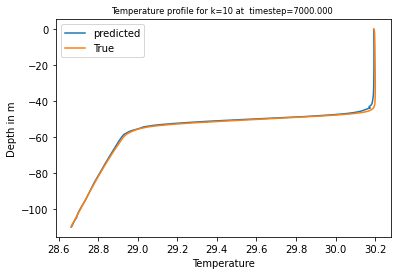

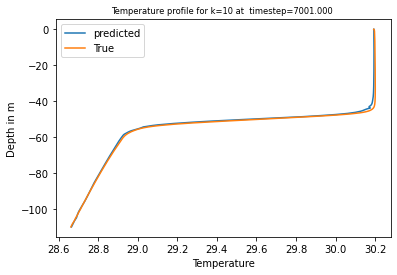

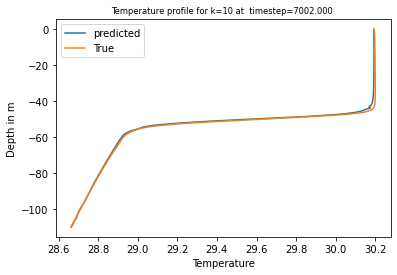

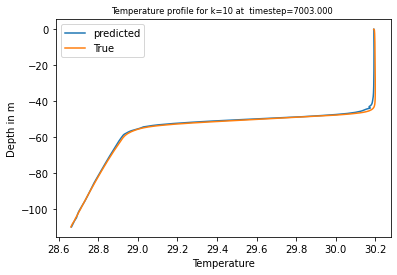

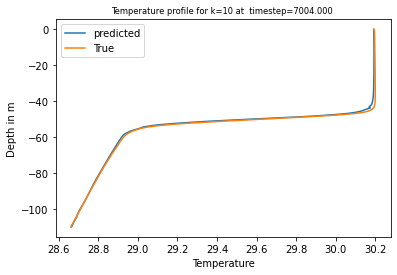

...

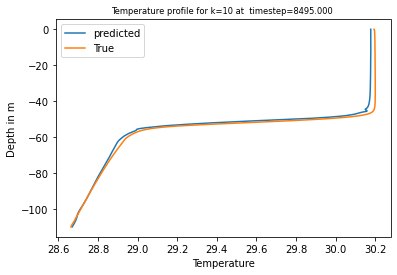

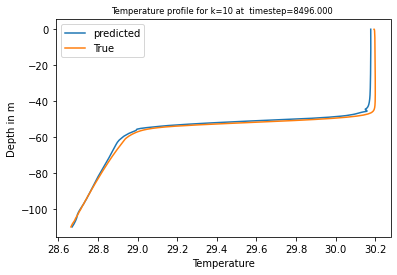

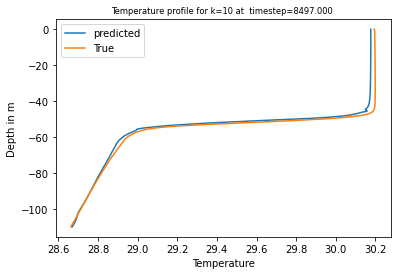

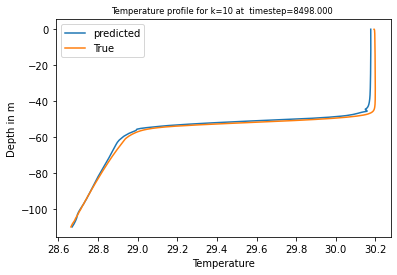

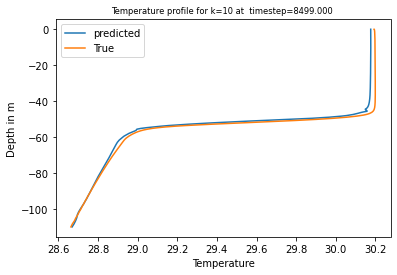

In [37]:
folder = 'images_Temp_future'
import os
p=0
timeSteps=p+7000
os.makedirs(folder, exist_ok=True)
for i in range(0,1500):#decoded_predictions.shape[0]):
    #if i%25==0:
        plt.figure(i)
        plt.plot(In.inv_transform(decoded_predictions[i:i+1,:,:].cpu().detach().numpy())[:,:,0].T,ZZ.T,label='predicted')
        plt.plot(In.inv_transform(True_tr[i:i+1,:,:])[:,:,0].T,ZZ.T,label='True')
        plt.xlabel('Temperature')
        plt.ylabel('Depth in m')
        plt.title(f'Temperature profile for k={time_step} at  timestep=%1.3f ' % timeSteps, fontsize='small')
        plt.legend()
        plt.savefig(folder + "/file%02d.png" % i)
        timeSteps=timeSteps+1



In [38]:
import os
import subprocess
os.chdir("images_Temp_future")
subprocess.call([
        'ffmpeg', '-framerate', '16', '-i', 'file%02d.png', '-r', '60', '-pix_fmt', 'yuv420p',
        'Temperature_future_1.mp4'])

ffmpeg version 4.2.4-1ubuntu0.1 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.3.0-10ubuntu2)
  configuration: --prefix=/usr --extra-version=1ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-l

0

In [1]:
fig, ax = plt.subplots(2,5, figsize=(20, 5))
days=hours/24
p = 0
timeSteps=p+1000
for i in range(2):
    for j in range(5):
        ax[i, j].plot(In.inv_transform(True_tr[p,:,:])[:,:,0].T,ZZ.T,label='True')
        ax[i, j].plot(In.inv_transform(decoded_predictions[p,:,:].cpu().detach().numpy())[:,:,0].T,ZZ.T,label='predicted')
        ax[i, j].legend(['True', 'Predicted'], fontsize='small')
        ax[i, j].set_xlabel('Temperature')
        ax[i, j].set_ylabel('Depth in m')
        ax[i, j].set_title(f'Temperature profile for k={time_step} at day=%1.3f ' % days[timeSteps], fontsize='small')
        p += 100
        timeSteps += 100

plt.tight_layout()
plt.show()

NameError: name 'plt' is not defined

"ax[0].plot(In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,-1,1], label='Predicted')\nax[0].plot(In.inv_transform(True_tr)[:,-1,1], label='True')\nax[0].set_title(f'Comparison between LES and LSTM-ROM SSS for k={time_step}')\nax[0].legend()"

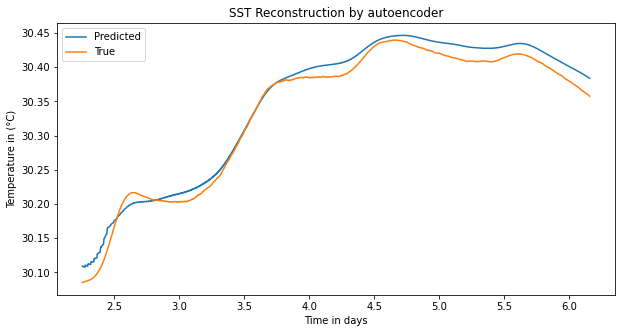

In [37]:
fig,ax= plt.subplots(1,1,figsize=(10,5))
ax.plot(hours[1000:3999]/24,In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:-1,-1,0], label='Predicted')
ax.plot(hours[1000:3999]/24,In.inv_transform(True_tr)[:-1,-1,0], label='True')
ax.set_title(f'Comparison between LES and LSTM-ROM SST for k={time_step}')
ax.set_xlabel('Time in days')
ax.set_ylabel('Temperature in (\u00b0C)')
ax.set_title('SST Reconstruction by autoencoder')
ax.legend()
'''ax[0].plot(In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,-1,1], label='Predicted')
ax[0].plot(In.inv_transform(True_tr)[:,-1,1], label='True')
ax[0].set_title(f'Comparison between LES and LSTM-ROM SSS for k={time_step}')
ax[0].legend()'''

/tmp/ipykernel_24438/2663330611.py:12: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  b=ax[0].pcolormesh(tt,xx,In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:-1,:,0],label='predicted')
/tmp/ipykernel_24438/2663330611.py:13: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  a=ax[1].pcolormesh(tt,xx,In.inv_transform(True_tr[:,:,:])[:-1,:,0],label='actual')


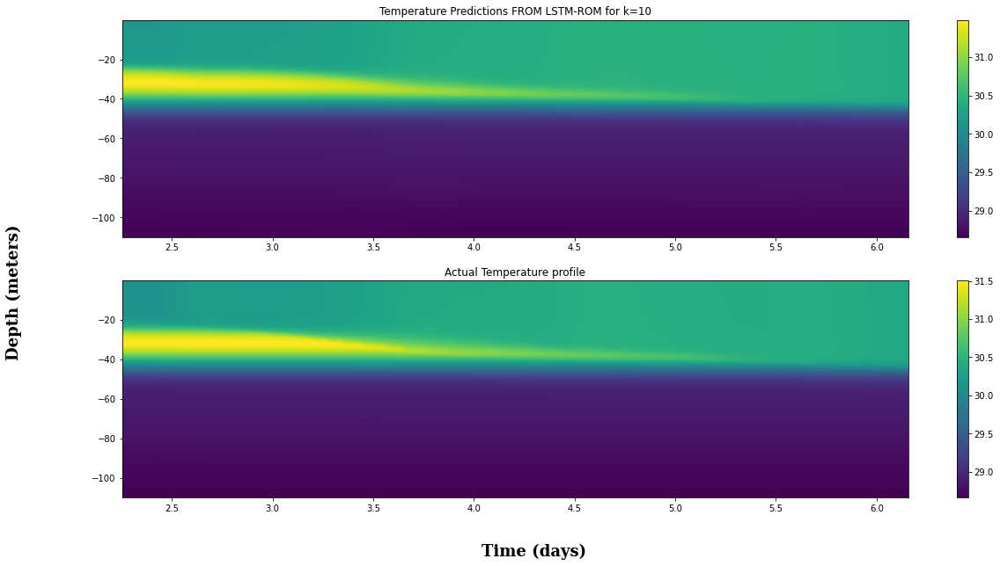

In [38]:
#pcolor plots
t=np.linspace(7000,8500,1500,endpoint=False)

[xx, tt] = np.meshgrid(ZZ.flatten(), hours[1000:3999]/24)
label_font = {'family': 'serif', 'weight': 'bold', 'size': 18}
fig,ax=plt.subplots(2,1,figsize=(20,10))
'''ax[1].pcolormesh(tt,xx,In.inv_transform(True_tr[:,:,:])[:,:,1],label='Actual')
ax[0].pcolormesh(tt,xx,In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,:,1],label='predicted')
ax[1].set_title(' Actual Salinity profile')
ax[0].set_title(f'Salinity Predictions from LSTM-ROM for k={time_step}')'''

b=ax[0].pcolormesh(tt,xx,In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:-1,:,0],label='predicted')
a=ax[1].pcolormesh(tt,xx,In.inv_transform(True_tr[:,:,:])[:-1,:,0],label='actual')
ax[1].set_title('Actual Temperature profile')
ax[0].set_title(f'Temperature Predictions FROM LSTM-ROM for k={time_step}')
fig.text(0.45, 0.04, 'Time (days)', ha='center', va='center',font=label_font)
fig.text(0.04, 0.45, 'Depth (meters)', ha='center', va='center', rotation='vertical',font=label_font)

fig.colorbar(b,ax=ax[0])
fig.colorbar(a,ax=ax[1])

/tmp/ipykernel_24438/2927983822.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im=ax.pcolormesh(tt,xx,In.inv_transform(True_tr[:,:,:])[:-1,:,0]-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:-1,:,0],label='predicted',norm=norm, cmap="RdBu_r")


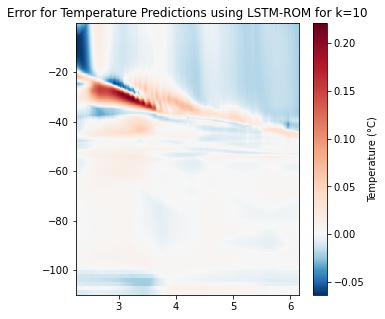

In [39]:
fig,ax=plt.subplots(1,1,figsize=(5,5))
from matplotlib.colors import TwoSlopeNorm

norm = TwoSlopeNorm(vmin=np.min(In.inv_transform(True_tr[:-1,:,:])[:,:,0]-In.inv_transform(decoded_predictions[:-1,:,:].cpu().detach().numpy())[:,:,0]), vcenter=0, vmax=np.max(In.inv_transform(True_tr[:,:,:])[:-1,:,0]-In.inv_transform(decoded_predictions[:-1,:,:].cpu().detach().numpy())[:,:,0]))


im=ax.pcolormesh(tt,xx,In.inv_transform(True_tr[:,:,:])[:-1,:,0]-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:-1,:,0],label='predicted',norm=norm, cmap="RdBu_r")
ax.set_title(f'Error for Temperature Predictions using LSTM-ROM for k={time_step}')

colo=plt.colorbar(im, ax=ax)
colo.set_label('Temperature (\u00b0C)')
plt.show()

/tmp/ipykernel_24438/241615955.py:17: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im=ax.pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:-1,:,:].cpu().detach().numpy())[:,:,0]-In.inv_transform(decoded_predictions[:-1,:,:].cpu().detach().numpy())[:,:,0],label='predicted',norm=norm, cmap="RdBu_r")


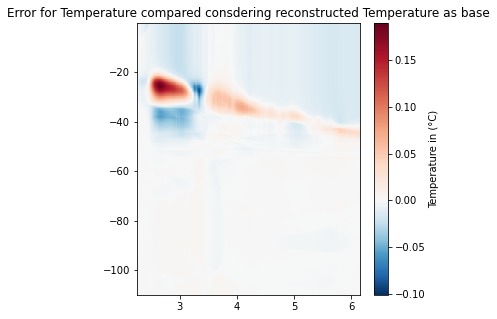

In [40]:
fig,ax=plt.subplots(1,1,figsize=(5,5))

'''im=ax.pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0]-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
ax.set_title('Error for Temperature compared consdering reconstructed temperature as base')

colo=plt.colorbar(im, ax=ax)
colo.set_label('Temperature (\u00b0C)')
plt.show()
'''
from matplotlib.colors import TwoSlopeNorm

norm = TwoSlopeNorm(vmin=np.min(In.inv_transform(x_rec[time_step:-1,:,:].cpu().detach().numpy())[:,:,0]-In.inv_transform(decoded_predictions[:-1,:,:].cpu().detach().numpy())[:,:,0]), vcenter=0, vmax=np.max(In.inv_transform(x_rec[time_step:-1,:,:].cpu().detach().numpy())[:,:,0]-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:-1,:,0]))




im=ax.pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:-1,:,:].cpu().detach().numpy())[:,:,0]-In.inv_transform(decoded_predictions[:-1,:,:].cpu().detach().numpy())[:,:,0],label='predicted',norm=norm, cmap="RdBu_r")
ax.set_title('Error for Temperature compared consdering reconstructed Temperature as base')

colo=plt.colorbar(im, ax=ax)
colo.set_label('Temperature in (\u00b0C)')
plt.show()


In [ ]:
xtra=torch.zeros(6501, 240, 5).to(device)
decoded_predictions=model.decoder(reduced_Train,xtra)

In [ ]:
print(x.shape)
print(decoded_predictions.shape)

In [ ]:
for i in range(decoded_predictions.shape[0]):
    if i%250==0:
        plt.figure(i)
        plt.plot(In.inv_transform(decoded_predictions[i:i+1,:,:].cpu().detach().numpy())[:,:,1].T,ZZ.T,label='predicted')
        plt.plot(x[i:i+1,:,1].T,ZZ.T,label='True')
        plt.legend()
        j=j+1

In [ ]:
fig,ax= plt.subplots(2,1,figsize=(10,10))

ax[0].plot(In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,-1,0], label='Predicted')
ax[0].plot((x)[:,-1,0], label='True')
ax[0].legend()
ax[1].plot(In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,-1,1], label='Predicted')
ax[1].plot((x)[:,-1,1], label='True')
ax[1].legend()

## Decoding for predictions (No thermal Inversion layer)

In [ ]:
pred=loadmat('predictions_encodings.mat')
predictions_enc=pred['pred']
print(predictions_enc.shape)
predictions_enc=torch.from_numpy(predictions_enc).float().to(device)

In [ ]:
x=torch.zeros(8500, 240, 5).to(device)

In [ ]:
decoded_predictions=model.decoder(predictions_enc,x)


In [ ]:
print(decoded_predictions.shape)
print(Test_NTI_tr[11:,:,:].shape)

In [ ]:
for i in range(decoded_predictions.shape[0]):
    if i%250==0:
        plt.figure(i)
        plt.plot(In.inv_transform(decoded_predictions[i:i+1,:,:].cpu().detach().numpy())[:,:,0].T,ZZ.T,label='predicted')
        plt.plot(In.inv_transform(Test_NTI_tr[i+11:i+1+11,:,:])[:,:,0].T,ZZ.T,label='True')
        plt.legend()


In [ ]:
fig,ax= plt.subplots(1,1,figsize=(10,5))
ax.plot(tes.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,-1,0], label='Predicted')
ax.plot(tes.inv_transform(Test_NTI_tr)[:,-1,0], label='True')
ax.set_title(f'Comparison between LES and LSTM-ROM SST for k={time_step}')
ax.legend()

In [ ]:
#pcolor plots
t=np.linspace(1,8500,8500,endpoint=False)
[xx, tt] = np.meshgrid(ZZ.flatten(), t)

fig,ax=plt.subplots(2,1,figsize=(20,10))

ax[0].pcolormesh(tt,xx,In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
ax[1].pcolormesh(tt,xx,In.inv_transform(Test_NTI_tr[11:,:,:])[:,:,0],label='actual')
ax[1].set_title('Actual Temperature profile')
ax[0].set_title(f'Temperature Predictions FROM LSTM-ROM for k={time_step}')